In [1]:
# import dependencies
import pandas as pd
import sqlite3
from datetime import datetime, timedelta
from fbprophet import Prophet

from fbprophet.plot import plot_plotly
import plotly.offline as py

import plotly.offline as py
import plotly.graph_objs as go

In [2]:
# Create your connections with indoor and outdoor databases
Ocnx = sqlite3.connect('Outdoor.db')
Icnx = sqlite3.connect('Indoor.db')
Outdoor_df = pd.read_sql_query("SELECT * FROM BME_DATA", Ocnx)
Indoor_df = pd.read_sql_query("SELECT * FROM BME_DATA", Icnx)

In [3]:
# Convert time into datetime
Outdoor_df['TIME_STAMP'] = pd.to_datetime(Outdoor_df['TIME_STAMP'])
Indoor_df['TIME_STAMP'] = pd.to_datetime(Indoor_df['TIME_STAMP'])

In [4]:
Outdoor_df['TIME_STAMP'] = Outdoor_df['TIME_STAMP'].dt.round('60min')
Indoor_df['TIME_STAMP'] = Indoor_df['TIME_STAMP'].dt.round('1min')
Outdoor_df.head()

,id,TIME_STAMP,TEMPERATURE,GAS,HUMIDITY,PRESSURE,ALTITUDE
0,1,2019-05-12 19:00:00,75.0,100,50.0,1000.0,1000.0
1,2,2019-05-12 19:00:00,23.8,364884,84.9,975.0,323.2
2,3,2019-05-12 19:00:00,23.8,362475,84.6,975.0,323.3
3,4,2019-05-12 19:00:00,23.8,362874,84.2,975.0,323.4
4,5,2019-05-12 19:00:00,23.8,362475,84.4,975.0,323.5


In [5]:
Indoor_df.head()

,id,TIME_STAMP,TEMPERATURE,GAS,HUMIDITY,PRESSURE,ALTITUDE
0,1,2019-05-12 18:53:00,75.0,100,50.0,1000.0,1000.0
1,2,2019-05-12 18:58:00,23.5,6049661,35.9,972.9,341.2
2,3,2019-05-12 18:59:00,23.5,5851528,35.9,972.9,341.3
3,4,2019-05-12 19:00:00,23.4,5636172,36.2,972.9,341.4
4,5,2019-05-12 19:01:00,23.5,5441624,37.3,972.9,341.5


In [6]:
# Deleting the wrong input at the first rows
Outdoor_df = Outdoor_df.iloc[1:]
Indoor_df = Indoor_df.iloc[1:]

In [7]:
# converting temperature from C to f
Outdoor_df['TEMPERATURE'] = round((Outdoor_df['TEMPERATURE']* 9/5) + 32)
Indoor_df['TEMPERATURE'] = round((Indoor_df['TEMPERATURE']* 9/5) + 32)

In [8]:
# Merging Indor and Outdoor (on time stamp)
master_df = pd.merge(Outdoor_df, Indoor_df, on = "TIME_STAMP", how = "left", suffixes=("_Out","_In"))


In [9]:
# Dropping NAs
master_df= master_df.dropna()
master_df.head()

,id_Out,TIME_STAMP,TEMPERATURE_Out,GAS_Out,HUMIDITY_Out,PRESSURE_Out,ALTITUDE_Out,id_In,TEMPERATURE_In,GAS_In,HUMIDITY_In,PRESSURE_In,ALTITUDE_In
0,2,2019-05-12 19:00:00,75.0,364884,84.9,975.0,323.2,4.0,74.0,5636172.0,36.2,972.9,341.4
1,3,2019-05-12 19:00:00,75.0,362475,84.6,975.0,323.3,4.0,74.0,5636172.0,36.2,972.9,341.4
2,4,2019-05-12 19:00:00,75.0,362874,84.2,975.0,323.4,4.0,74.0,5636172.0,36.2,972.9,341.4
3,5,2019-05-12 19:00:00,75.0,362475,84.4,975.0,323.5,4.0,74.0,5636172.0,36.2,972.9,341.4
4,6,2019-05-12 19:00:00,75.0,362874,84.4,975.0,323.5,4.0,74.0,5636172.0,36.2,972.9,341.4


In [10]:
# Creating indoor and Outdoor Datasets
outdoor = master_df.loc[:,["TIME_STAMP", "TEMPERATURE_Out"]]
indoor = master_df.loc[:,["TIME_STAMP", "TEMPERATURE_In"]]
outdoor.columns = ['ds', 'y']
indoor.columns = ['ds', 'y']

In [11]:
# Building the model for inodor and outdoor
od = Prophet()
od.fit(outdoor)
ind = Prophet()
ind.fit(indoor)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
C:\Anaconda3\envs\pr3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
C:\Anaconda3\envs\pr3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



In [12]:
# Outdoor forecasting
od_future = od.make_future_dataframe(periods= 1)
od_forecast = od.predict(od_future)
od_forecast.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-05-12 19:00:00,66.684919,73.188677,76.365560,66.684919,66.684919,8.093974,8.093974,8.093974,8.093974,8.093974,8.093974,0.0,0.0,0.0,74.778893
1,2019-05-12 19:00:00,66.684919,73.102442,76.471857,66.684919,66.684919,8.093974,8.093974,8.093974,8.093974,8.093974,8.093974,0.0,0.0,0.0,74.778893
2,2019-05-12 19:00:00,66.684919,73.020477,76.464561,66.684919,66.684919,8.093974,8.093974,8.093974,8.093974,8.093974,8.093974,0.0,0.0,0.0,74.778893
3,2019-05-12 19:00:00,66.684919,73.206532,76.401718,66.684919,66.684919,8.093974,8.093974,8.093974,8.093974,8.093974,8.093974,0.0,0.0,0.0,74.778893
4,2019-05-12 19:00:00,66.684919,73.235987,76.432711,66.684919,66.684919,8.093974,8.093974,8.093974,8.093974,8.093974,8.093974,0.0,0.0,0.0,74.778893


In [13]:
# Indoor forecasting
ind_future = ind.make_future_dataframe(periods= 1)
ind_forecast = ind.predict(ind_future)
ind_forecast.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-05-12 19:00:00,73.215251,73.072987,74.344687,73.215251,73.215251,0.539374,0.539374,0.539374,0.539374,0.539374,0.539374,0.0,0.0,0.0,73.754625
1,2019-05-12 19:00:00,73.215251,73.048955,74.413666,73.215251,73.215251,0.539374,0.539374,0.539374,0.539374,0.539374,0.539374,0.0,0.0,0.0,73.754625
2,2019-05-12 19:00:00,73.215251,73.039110,74.433332,73.215251,73.215251,0.539374,0.539374,0.539374,0.539374,0.539374,0.539374,0.0,0.0,0.0,73.754625
3,2019-05-12 19:00:00,73.215251,73.072843,74.451958,73.215251,73.215251,0.539374,0.539374,0.539374,0.539374,0.539374,0.539374,0.0,0.0,0.0,73.754625
4,2019-05-12 19:00:00,73.215251,73.096528,74.420312,73.215251,73.215251,0.539374,0.539374,0.539374,0.539374,0.539374,0.539374,0.0,0.0,0.0,73.754625


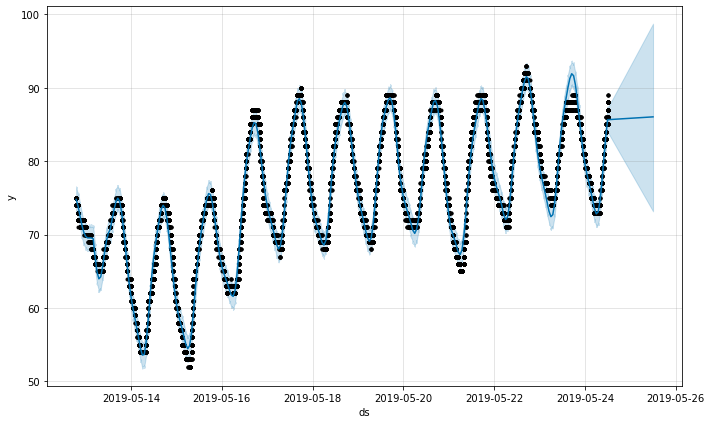

In [14]:
# Outdoor plot with forecasting
od_plot = od.plot(od_forecast)

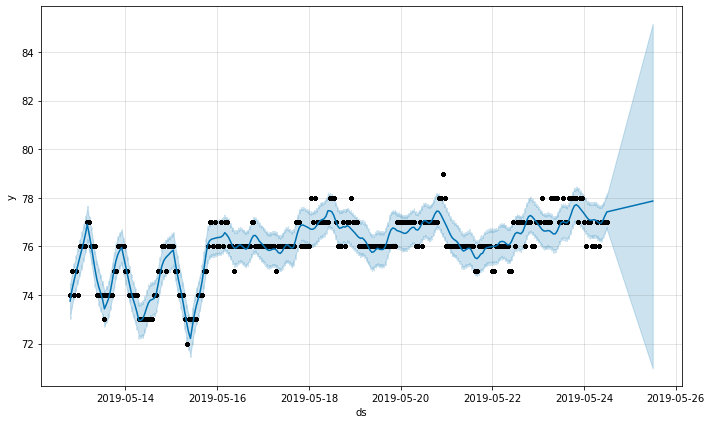

In [15]:
# Indoor plot with forecasting
ind_plot = ind.plot(ind_forecast)

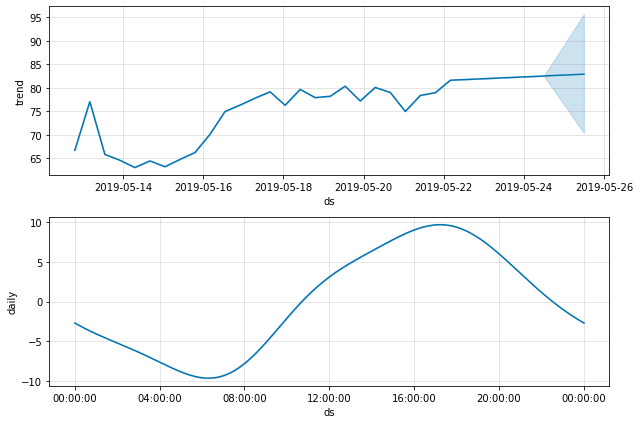

In [16]:
# Print outdoor trend and daily component
od_fig1 = od.plot_components(od_forecast)

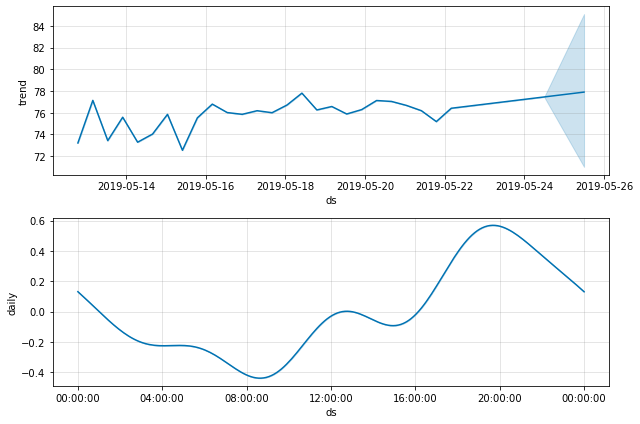

In [17]:
# Print indoor trend and daily component
ind_fig1 = ind.plot_components(ind_forecast)

In [18]:
# Print outdoor 
py.init_notebook_mode()
od_fig = plot_plotly(od, od_forecast)  # This returns a plotly Figure
py.iplot(od_fig)

In [19]:
# Print indoor plotly figure
ind_fig = plot_plotly(ind, ind_forecast)  # This returns a plotly Figure
py.iplot(ind_fig)

In [20]:
# Producing full plot for outdoor data
py.iplot([
    go.Scatter(x=outdoor['ds'], y=outdoor['y'], name='y'),
    go.Scatter(x=od_forecast['ds'], y=od_forecast['yhat'], name='yhat'),
    go.Scatter(x=od_forecast['ds'], y=od_forecast['yhat_upper'], fill='tonexty', mode='none', name='upper'),
    go.Scatter(x=od_forecast['ds'], y=od_forecast['yhat_lower'], fill='tonexty', mode='none', name='lower'),
    go.Scatter(x=od_forecast['ds'], y=od_forecast['trend'], name='Trend')
])

In [21]:
# Producing full plot for indoor data
py.iplot([
    go.Scatter(x=indoor['ds'], y=indoor['y'], name='y'),
    go.Scatter(x=ind_forecast['ds'], y=ind_forecast['yhat'], name='yhat'),
    go.Scatter(x=ind_forecast['ds'], y=ind_forecast['yhat_upper'], fill='tonexty', mode='none', name='upper'),
    go.Scatter(x=ind_forecast['ds'], y=ind_forecast['yhat_lower'], fill='tonexty', mode='none', name='lower'),
    go.Scatter(x=ind_forecast['ds'], y=ind_forecast['trend'], name='Trend')
])